# Camera calibration using CHARUCO

In [1]:
import numpy as np
import cv2, PIL, os, glob
from cv2 import aruco
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import matplotlib as mpl
import pandas as pd
%matplotlib nbagg
from PIL import Image


In [2]:
print(os.path.abspath(os.curdir))

F:\Projects\Tremor


In [3]:
aruco_dict = aruco.Dictionary_get(aruco.DICT_4X4_50)
board = aruco.CharucoBoard_create(7, 5, 1, 0.5, aruco_dict)
# img = board.draw((3508, 2480))
# Image.fromarray(img).save("123.jpg", "JPEG")

And take photos of it from multiple angles, for example:

In [4]:
def photo_files(path, sort=True):
    d = os.path.abspath(os.curdir)
    os.chdir(path)
    l = ["%s\\%s" % (path, file) for file in glob.glob("*.jpg")]
    os.chdir(d)
    l = np.asarray(l)
    return np.sort(l) if sort else l

images = photo_files('.\\Calibration photo')
print(images)

['.\\Calibration photo\\_SAM0694.JPG' '.\\Calibration photo\\_SAM0695.JPG'
 '.\\Calibration photo\\_SAM0696.JPG' '.\\Calibration photo\\_SAM0697.JPG'
 '.\\Calibration photo\\_SAM0698.JPG' '.\\Calibration photo\\_SAM0700.JPG'
 '.\\Calibration photo\\_SAM0701.JPG' '.\\Calibration photo\\_SAM0702.JPG'
 '.\\Calibration photo\\_SAM0703.JPG' '.\\Calibration photo\\_SAM0704.JPG']


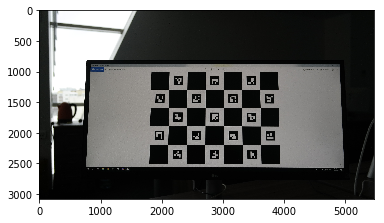

In [5]:
im = PIL.Image.open(images[0])
fig = plt.figure()
ax = fig.add_subplot(1,1,1)
plt.imshow(im)
#ax.axis('off')
plt.show()

Now, the camera calibration can be done using all the images of the chessboard. Two functions are necessary:

* The first will detect markers on all the images and.
* The second will proceed the detected markers to estimage the camera calibration data.

In [6]:
def read_chessboards(images):
    """
    Charuco base pose estimation.
    """
    print("POSE ESTIMATION STARTS:")
    allCorners = []
    allIds = []
    decimator = 0
    # SUB PIXEL CORNER DETECTION CRITERION
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.00001)

    for im in images:
        print("=> Processing image {0}".format(im))
        frame = cv2.imread(im)
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        corners, ids, rejectedImgPoints = cv2.aruco.detectMarkers(gray, aruco_dict)
        
        if len(corners)>0:
            # SUB PIXEL DETECTION
            for corner in corners:
                cv2.cornerSubPix(gray, corner, 
                                 winSize = (3,3), 
                                 zeroZone = (-1,-1), 
                                 criteria = criteria)
            res2 = cv2.aruco.interpolateCornersCharuco(corners,ids,gray,board)        
            if res2[1] is not None and res2[2] is not None and len(res2[1])>3 and decimator%1==0:
                allCorners.append(res2[1])
                allIds.append(res2[2])              
        
        decimator+=1   

    imsize = gray.shape
    return allCorners, allIds, imsize


In [7]:
allCorners,allIds,imsize=read_chessboards(images)


POSE ESTIMATION STARTS:
=> Processing image .\Calibration photo\_SAM0694.JPG
=> Processing image .\Calibration photo\_SAM0695.JPG
=> Processing image .\Calibration photo\_SAM0696.JPG
=> Processing image .\Calibration photo\_SAM0697.JPG
=> Processing image .\Calibration photo\_SAM0698.JPG
=> Processing image .\Calibration photo\_SAM0700.JPG
=> Processing image .\Calibration photo\_SAM0701.JPG
=> Processing image .\Calibration photo\_SAM0702.JPG
=> Processing image .\Calibration photo\_SAM0703.JPG
=> Processing image .\Calibration photo\_SAM0704.JPG


In [8]:
def calibrate_camera(allCorners,allIds,imsize):   
    """
    Calibrates the camera using the dected corners.
    """
    print("CAMERA CALIBRATION")
    
    cameraMatrixInit = np.array([[ 1000.,    0., imsize[0]/2.],
                                 [    0., 1000., imsize[1]/2.],
                                 [    0.,    0.,           1.]])

    distCoeffsInit = np.zeros((5,1))
    flags = (cv2.CALIB_USE_INTRINSIC_GUESS + cv2.CALIB_RATIONAL_MODEL + cv2.CALIB_FIX_ASPECT_RATIO) 
    #flags = (cv2.CALIB_RATIONAL_MODEL) 
    (ret, camera_matrix, distortion_coefficients0, 
     rotation_vectors, translation_vectors,
     stdDeviationsIntrinsics, stdDeviationsExtrinsics, 
     perViewErrors) = cv2.aruco.calibrateCameraCharucoExtended(
                      charucoCorners=allCorners,
                      charucoIds=allIds,
                      board=board,
                      imageSize=imsize,
                      cameraMatrix=cameraMatrixInit,
                      distCoeffs=distCoeffsInit,
                      flags=flags,
                      criteria=(cv2.TERM_CRITERIA_EPS & cv2.TERM_CRITERIA_COUNT, 10000, 1e-9))

    return ret, camera_matrix, distortion_coefficients0, rotation_vectors, translation_vectors

In [61]:
%time ret, mtx, dist, rvecs, tvecs = calibrate_camera(allCorners,allIds,imsize)

CAMERA CALIBRATION
Wall time: 317 ms


In [10]:
ret

27.06465675233636

In [59]:
mtx

array([[1.92411582e+03, 0.00000000e+00, 2.74351364e+03],
       [0.00000000e+00, 1.92411582e+03, 3.41051967e+03],
       [0.00000000e+00, 0.00000000e+00, 1.00000000e+00]])

In [60]:
dist

123.2672821602958

### Check calibration results

(3080, 5472, 3) (3080, 5472, 3)
(3080, 5472, 3) (3080, 5472, 3)
(3080, 5472, 3) (3080, 5472, 3)
(3080, 5472, 3) (3080, 5472, 3)
(3080, 5472, 3) (3080, 5472, 3)
(3080, 5472, 3) (3080, 5472, 3)
(3080, 5472, 3) (3080, 5472, 3)
(3080, 5472, 3) (3080, 5472, 3)
(3080, 5472, 3) (3080, 5472, 3)
(3080, 5472, 3) (3080, 5472, 3)


<Figure size 432x288 with 0 Axes>

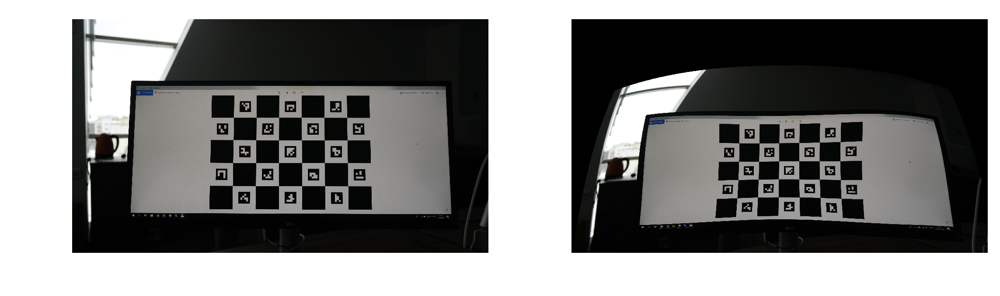

<Figure size 432x288 with 0 Axes>

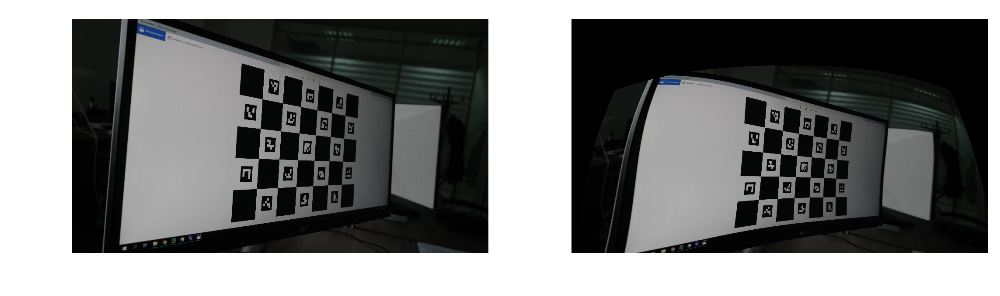

<Figure size 432x288 with 0 Axes>

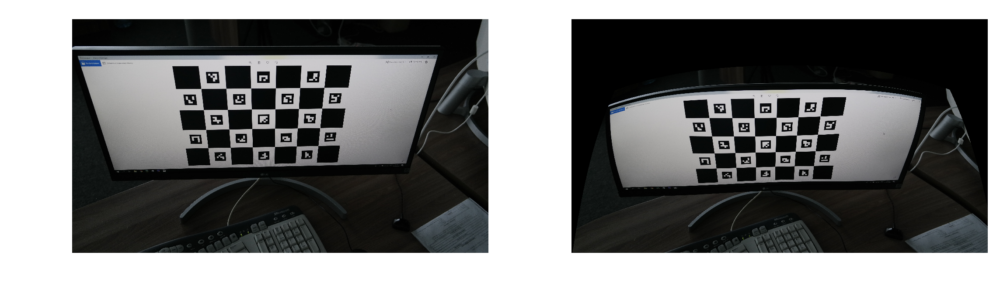

<Figure size 432x288 with 0 Axes>

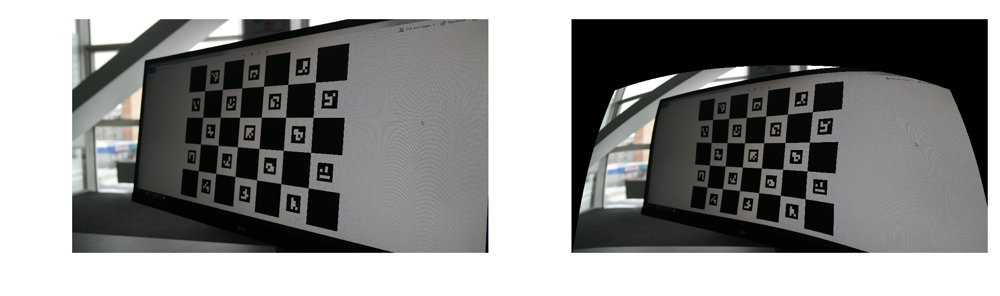

<Figure size 432x288 with 0 Axes>

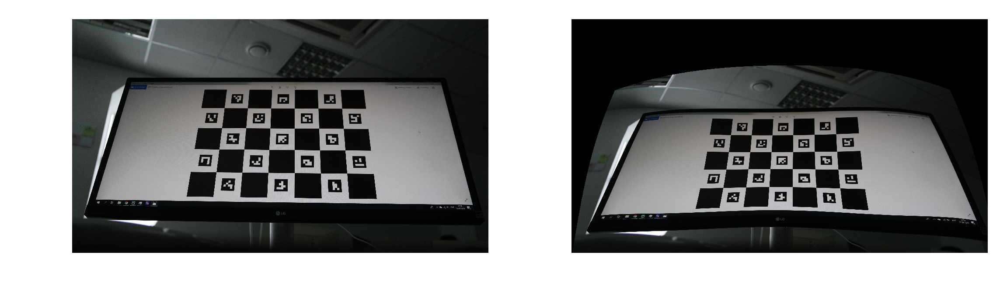

<Figure size 432x288 with 0 Axes>

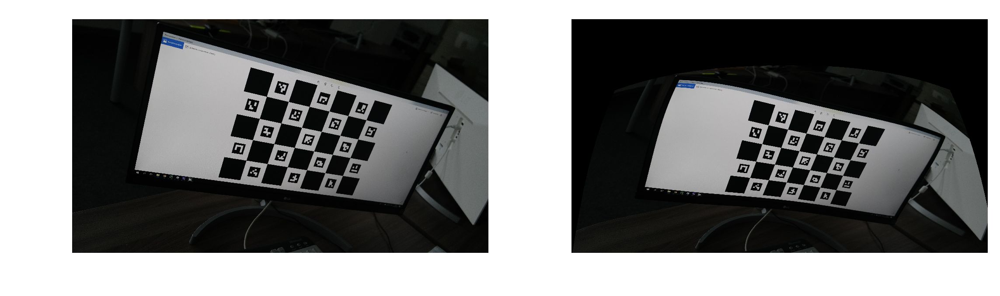

<Figure size 432x288 with 0 Axes>

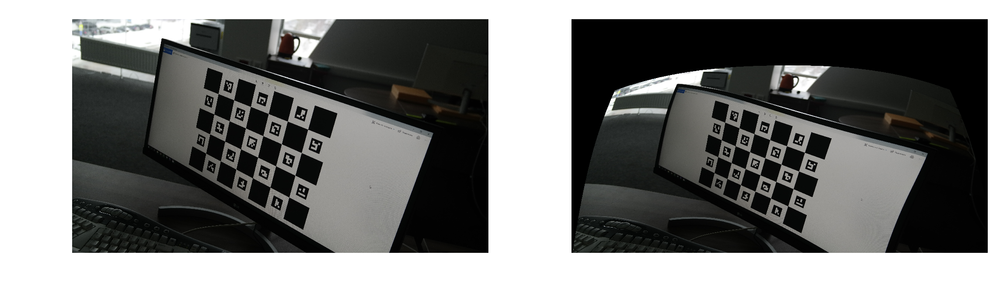

<Figure size 432x288 with 0 Axes>

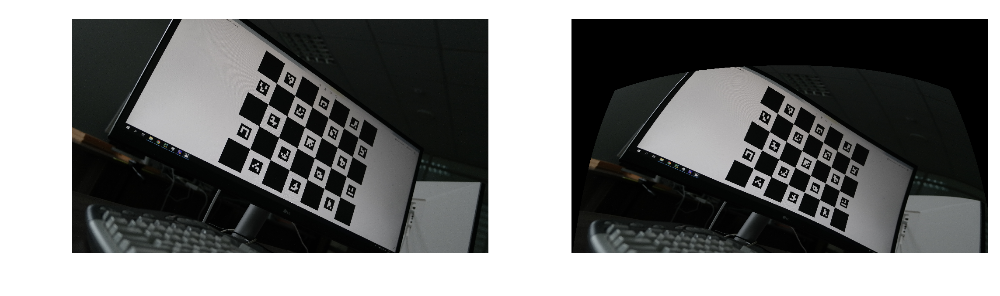

<Figure size 432x288 with 0 Axes>

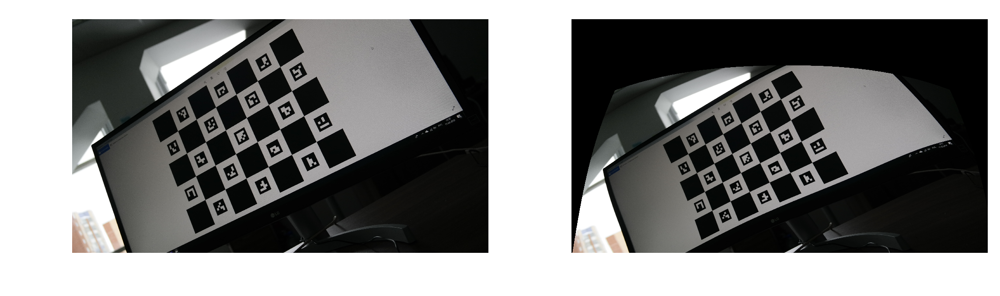

<Figure size 432x288 with 0 Axes>

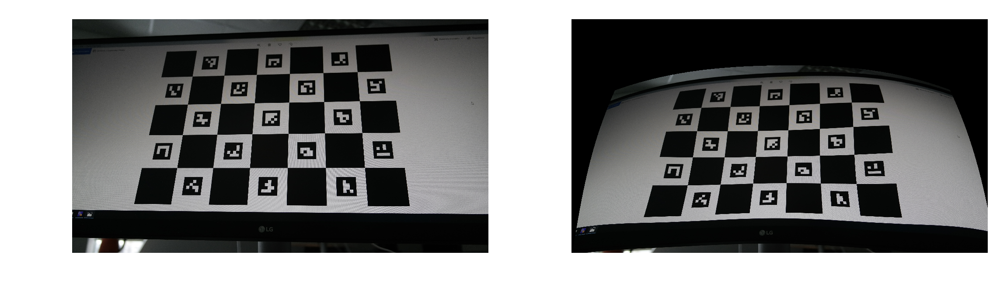

In [13]:
#i=4 # select image id
for i in range(len(images)):
    plt.figure()
    frame = np.asarray(Image.open(images[i]))
    img_undist = cv2.undistort(frame,mtx,dist,None)
    #plt.subplot(1,2,1)
    #plt.imshow(frame)
    #plt.title("Raw image")
    #plt.axis("off")
    #plt.subplot(1,2,2)
    #plt.imshow(img_undist)
    #plt.title("Corrected image")
    #plt.axis("off")
    #plt.savefig('до после.jpg', dpi=300)
    #plt.show()
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 16), dpi=300, clear=True)
    
    print(frame.shape, img_undist.shape)
    ax1.imshow(frame)
    ax2.imshow(img_undist)
    ax1.axis('off')
    ax2.axis('off')
    f.savefig('до после #%d.jpg'%i, dpi=300, bbox_inches='tight')


## 3 . Use of camera calibration to estimate 3D translation and rotation of each marker on a scene

['.\\Check calibration photo\\_SAM0689.JPG'
 '.\\Check calibration photo\\_SAM0690.JPG'
 '.\\Check calibration photo\\_SAM0691.JPG'
 '.\\Check calibration photo\\_SAM0692.JPG'
 '.\\Check calibration photo\\_SAM0693.JPG']


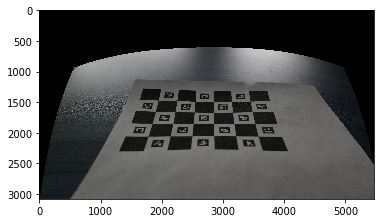

In [74]:
#check_photos = photo_files(r'.\Check calibration photo\Cal check\X2')
check_photos = photo_files('.\\Check calibration photo')
print(check_photos)
frame = cv2.imread(check_photos[4])
frame = cv2.undistort(src = frame, cameraMatrix = mtx, distCoeffs = dist)
plt.figure()
plt.imshow(frame, interpolation = "nearest")
plt.show()

## Post processing

In [75]:
gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
aruco_dict = aruco.Dictionary_get(aruco.DICT_4X4_50)
parameters =  aruco.DetectorParameters_create()
corners, ids, rejectedImgPoints = aruco.detectMarkers(gray, aruco_dict, 
                                                      parameters=parameters)
# SUB PIXEL DETECTION
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.0001)
for corner in corners:
    cv2.cornerSubPix(gray, corner, winSize = (3,3), zeroZone = (-1,-1), criteria = criteria)
    
frame_markers = aruco.drawDetectedMarkers(frame.copy(), corners, ids)

corners

[array([[[3644., 1912.],
         [3810., 1914.],
         [3842., 2003.],
         [3672., 2005.]]], dtype=float32), array([[[2271.8909, 1903.0894],
         [2433.    , 1906.    ],
         [2421.4517, 2003.1517],
         [2254.1907, 2004.1292]]], dtype=float32), array([[[1577.2924, 1903.505 ],
         [1751.    , 1903.    ],
         [1713.4752, 2007.4403],
         [1537.    , 1999.    ]]], dtype=float32), array([[[3544.0273, 1533.0792],
         [3705.9658, 1526.6106],
         [3729.4834, 1616.0497],
         [3563.5579, 1619.5837]]], dtype=float32), array([[[1867.    , 2120.    ],
         [2044.    , 2118.    ],
         [2013.0889, 2225.325 ],
         [1825.4038, 2231.6672]]], dtype=float32), array([[[3324.    , 2118.    ],
         [3500.4617, 2113.243 ],
         [3539.4229, 2222.205 ],
         [3354.    , 2221.    ]]], dtype=float32), array([[[2590.    , 2115.    ],
         [2763.555 , 2108.22  ],
         [2772.    , 2208.    ],
         [2588.0042, 2210.3267]]], dtyp

Very fast processing !

## Results

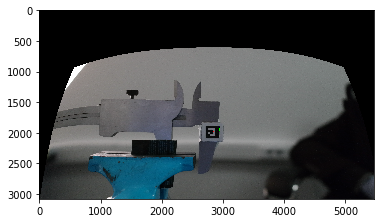

In [64]:
plt.figure()
plt.imshow(frame_markers, interpolation = "nearest")
plt.savefig("marked.jpg")
#plt.show()


### Add local axis on each marker

In [76]:
size_of_marker =  10 # side lenght of the marker in millimeters
rvecs,tvecs, _ = aruco.estimatePoseSingleMarkers(corners, size_of_marker , mtx, dist)

In [81]:
length_of_axis = 10
imaxis = aruco.drawDetectedMarkers(frame.copy(), corners, ids)

for i in range(len(tvecs)):
    imaxis = aruco.drawAxis(imaxis, mtx, dist, rvecs[i], tvecs[i], length_of_axis)

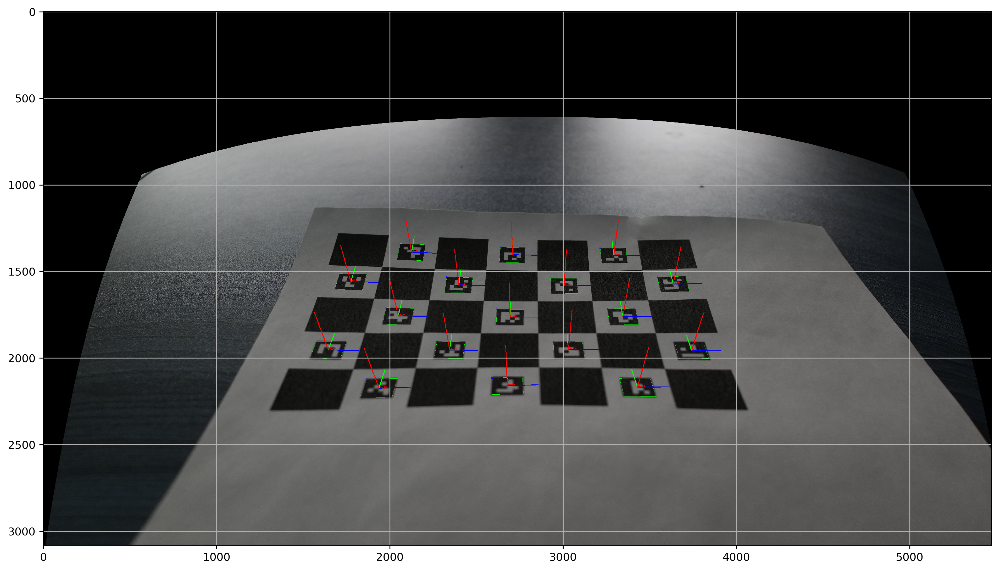

In [82]:
plt.figure(figsize=(16,9), dpi=300)
plt.imshow(imaxis)
plt.grid()
plt.show()

In [89]:
# data = pd.DataFrame(data = tvecs.reshape(len(tvecs),3), columns = ["tx", "ty", "tz"], 
#                     index = ids.flatten())
# data.index.name = "marker"
# data.sort_index(inplace= True)
# data
#rvecs
#tvec1 = tvecs
#tvecs[0,0]
#tvec1[0,0]
#d = np.linalg.norm(tvec1[0,0]-tvecs[0,0])
#d
import math
np.linalg.norm(rvecs[0,0])/math.pi*180

147.26412391104088

In [305]:

datar = pd.DataFrame(data = tvecs.reshape(len(rvecs),3), columns = ["rx", "ry", "rz"], 
                    index = ids.flatten())
datar.index.name = "marker"
datar.sort_index(inplace= True)
np.degrees(datar)


,rx,ry,rz
marker,,,
0,3.345263,10.636263,11.272638
1,-0.590286,9.516639,11.653392
2,-4.616715,8.957911,12.707418
3,6.649625,10.836080,12.431815
4,2.375792,9.495585,12.578208
5,-1.567306,8.493977,13.031201
6,-5.768467,8.042731,14.418019
7,5.566548,9.563349,13.682404
8,1.325893,7.877812,13.085270


In [306]:
v = data.loc[3:6].values
((v[1:] - v[:-1])**2).sum(axis = 1)**.5

array([0.07821726, 0.07144442, 0.07761642])

In [307]:
cv2.Rodrigues(rvecs[0], np.zeros((3,3)))

(array([[-0.86801078, -0.49450269, -0.04499303],
        [ 0.02324173,  0.05005109, -0.99847619],
        [ 0.49600111, -0.86773382, -0.03195179]]),
 array([[ 0.17008214, -0.35187266,  0.58606527, -0.60094699, -0.15414543,
         -0.02171528,  0.32580607,  0.19163346, -0.14667908],
        [ 0.2919512 , -0.48377297, -0.31537661,  0.54686264, -0.3578951 ,
         -0.00521095,  0.48529479,  0.25504826,  0.60693805],
        [-0.27940432,  0.44000776,  0.55432899, -0.27008959, -0.61042134,
         -0.03688581, -0.47630662, -0.28596013,  0.37208124]]))

<IPython.core.display.Javascript object>


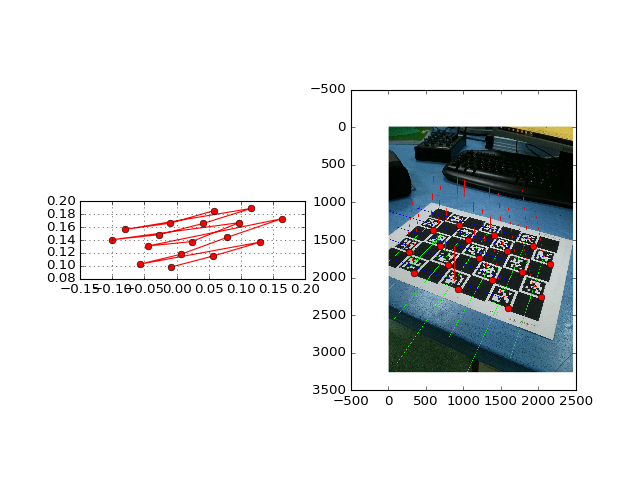

In [314]:
fig = plt.figure()
#ax = fig.add_subplot(111, projection='3d')
ax = fig.add_subplot(1,2,1)
ax.set_aspect("equal")
plt.plot(data.tx, data.ty, "or-")
plt.grid()
ax = fig.add_subplot(1,2,2)
plt.imshow(imaxis, origin = "upper")
plt.plot(np.array(corners)[:, 0, 0,0], np.array(corners)[:, 0, 0,1], "or")
plt.show()

In [66]:
a = np.arange(50)
a

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49])

In [291]:
import pickle

In [273]:
f = open("truc.pckl", "wb")
pickle.dump(a, f)
f.close()

In [274]:
f = open("truc.pckl", "rb")
b = pickle.load(f)
b == a

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True], dtype=bool)

In [137]:
corners = np.array(corners)
data2 = pd.DataFrame({"px": corners[:, 0, 0, 1], 
                      "py": corners[:, 0, 0, 0]}, index = ids.flatten())
data2.sort_index(inplace=True)
data2

,px,py
0,177.324295,222.723907
1,174.117722,448.426971
5,165.167435,1385.455933
6,292.872223,348.533112
7,290.211761,572.901550
8,286.861359,800.593140
9,285.043823,1029.405640
10,284.054932,1261.753418
11,406.743347,250.763550
12,405.577484,469.121307


In [321]:
m0 = data2.loc[0]
m43 = data2.loc[43]
d01 = ((m0 - m43).values**2).sum()**.5
d = 42.5e-3 * (3.5**2 + 4.5**2)**.5
factor = d / d01
data2["x"] = data2.px * factor
data2["y"] = data2.py * factor
((data2[["x", "y"]].loc[11] - data2[["x", "y"]].loc[0]).values**2).sum()**.5


0.043476117957396747

In [347]:

c = np.array(corners).astype(np.float64).reshape(44,4,2)
(((c[:, 1:] - c[:, :-1])**2).sum(axis = 2)**.5).mean(axis =1)

array([ 138.33575835,  143.00113377,  142.012097  ,  140.69699432,
        146.66782406,  144.02442319,  138.67845434,  142.33812925,
        143.00229095,  140.33926025,  140.35356753,  146.66786569,
        139.34054504,  146.67222201,  140.03570454,  148.01939184,
        143.35647769,  142.67236143,  147.01931296,  148.02127735,
        137.67392157,  135.35308209,  141.00354688,  143.67946992,
        137.67149733,  138.67392207,  145.00112611,  142.33454105,
        138.3466791 ,  143.00234925,  139.0035972 ,  143.00115739,
        143.6865917 ,  144.67964727,  144.33446711,  141.67253496,
        143.67117097,  147.67232772,  150.35663387,  141.70034559,
        149.01342342,  146.01949591,  144.34013329,  150.35333222])

In [343]:
c

array([[[ 2406.,  1940.],
        [ 2546.,  1940.],
        [ 2545.,  2075.],
        [ 2405.,  2076.]],

       [[ 1991.,  1938.],
        [ 2138.,  1939.],
        [ 2138.,  2076.],
        [ 1993.,  2076.]],

       [[ 1584.,  1936.],
        [ 1728.,  1936.],
        [ 1731.,  2073.],
        [ 1586.,  2072.]],

       [[ 2619.,  1735.],
        [ 2759.,  1735.],
        [ 2754.,  1878.],
        [ 2615.,  1877.]],

       [[ 2198.,  1734.],
        [ 2347.,  1734.],
        [ 2346.,  1878.],
        [ 2199.,  1878.]],

       [[  973.,  1733.],
        [ 1117.,  1731.],
        [ 1121.,  1874.],
        [  976.,  1875.]],

       [[  572.,  1732.],
        [  710.,  1732.],
        [  713.,  1874.],
        [  577.,  1873.]],

       [[ 2410.,  1533.],
        [ 2554.,  1533.],
        [ 2552.,  1672.],
        [ 2408.,  1672.]],

       [[ 1373.,  1326.],
        [ 1519.,  1325.],
        [ 1519.,  1463.],
        [ 1374.,  1464.]],

       [[ 1785.,  1326.],
        [ 1926.,  13

In [11]:
help(cv2.aruco.detectMarkers)

Help on built-in function detectMarkers:

detectMarkers(...)
    detectMarkers(image, dictionary[, corners[, ids[, parameters[, rejectedImgPoints]]]]) -> corners, ids, rejectedImgPoints



(480, 640, 3)